# Predicting Airline Fare

It is kind of regression problem where we need to utlize below listed Features to predict the target variable which is fare of journey. 
- Type of Airline
- Date of Journey
- Source of Journey
- Destination of Journey
- Route
- Departure Time
- Arrival Time
- Total Stops
- Additional Info






# Importing Necessary Libraries

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
pd.set_option("display.max_rows", None)


# Importing the Dataset

In [2]:
# read data
train = pd.read_excel('Data_Train.xlsx')

# Train data contains all features (Unit Number + setting parameters & sensor parameters)
# Test data contains all features (Unit Number + setting parameters & sensor parameters)
# Y_test contains RUL for the test data.
train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


# Inspecting the Dataset

In [3]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [4]:
# We can see that there are no null values in any of the column.

In [5]:
train.shape

(10683, 11)

In [6]:
# 11 features with 10683 columns

# Data Visualization + Data Processing

## Distribution Plot of Price

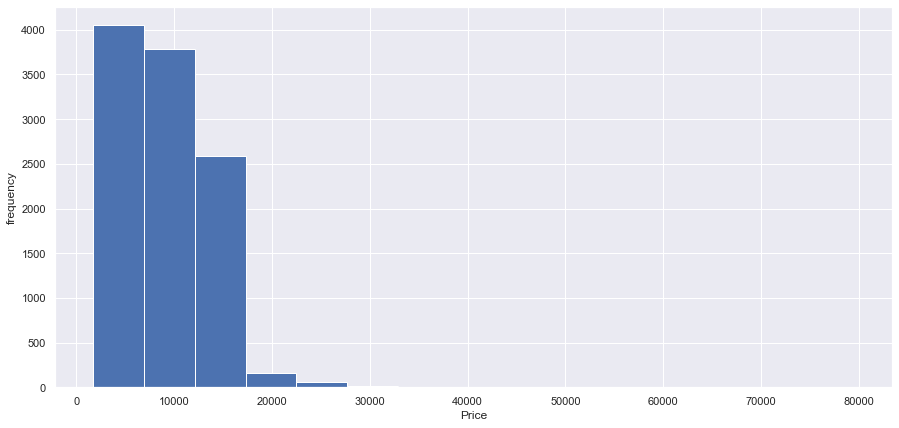

In [113]:
train['Price'].hist(bins=15, figsize=(15,7))
plt.xlabel('Price')
plt.ylabel('frequency')
plt.show()

## Feature Airline Type Vs Fare

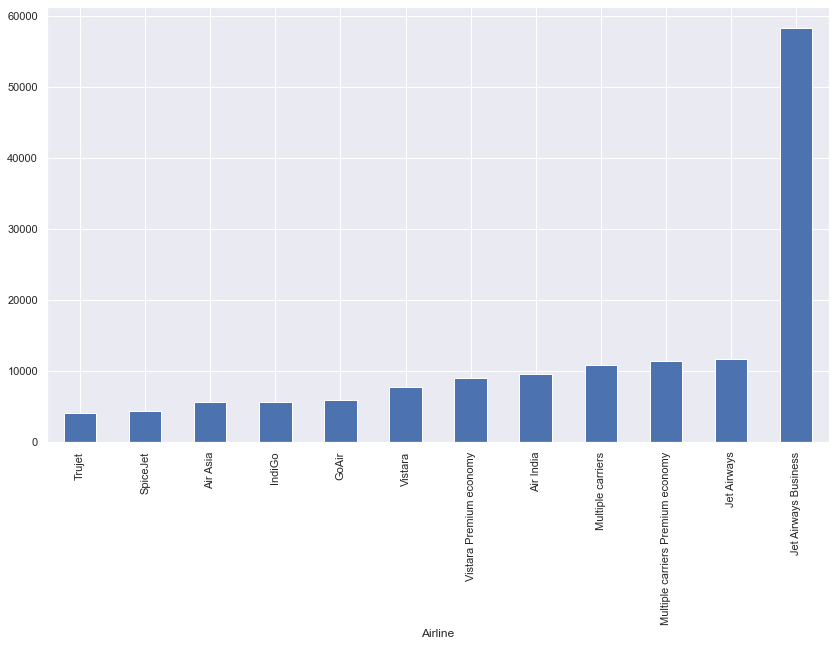

In [8]:
plt.figure(figsize=[14,8])

train.groupby(['Airline'])['Price'].mean().sort_values().plot.bar();

In [9]:
# We can see that price of jetbuisness is more that other flights

## Feature Source Vs Fare

In [10]:
train.Source.unique()

array(['Banglore', 'Kolkata', 'Delhi', 'Chennai', 'Mumbai'], dtype=object)

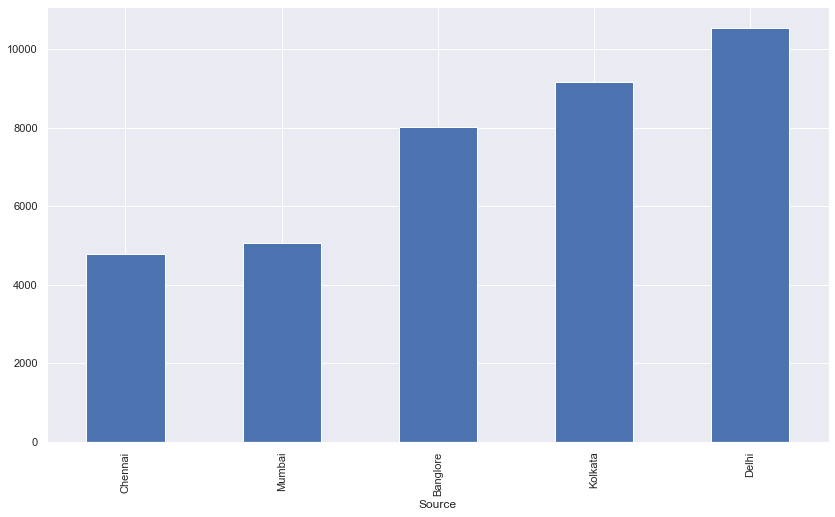

In [11]:
plt.figure(figsize=[14,8])

train.groupby(['Source'])['Price'].mean().sort_values().plot.bar();

In [12]:
# We can see that pattern is there. Price for Delhi & Kolkata is higher.

## Feature Destination Vs Fare

In [13]:
train.Destination.unique()

array(['New Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Delhi', 'Hyderabad'],
      dtype=object)

In [14]:
# We can see that there are two entries for Delhi i.e. Delhi & New Delhi thereofore we will replace Delhi with Delhi.
train['Destination']=train['Destination'].apply(lambda x:'Delhi' if x=='New Delhi'else x)

In [15]:
train.Destination.unique()

array(['Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Hyderabad'],
      dtype=object)

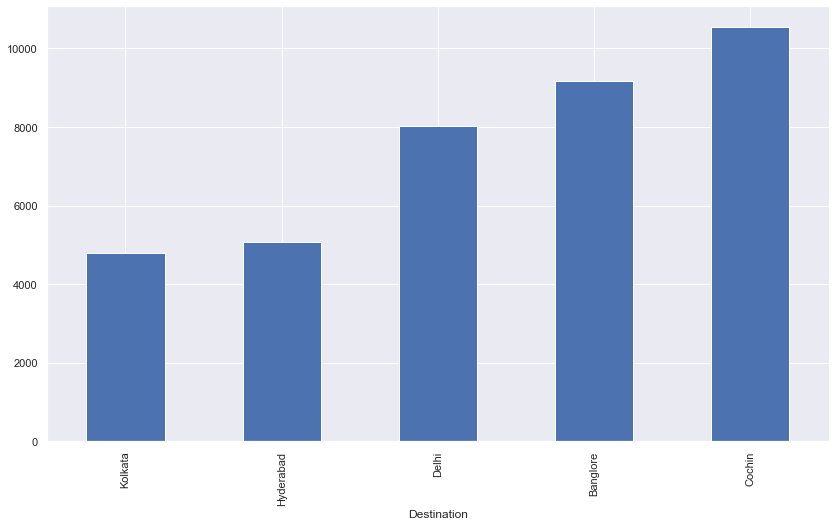

In [16]:
plt.figure(figsize=[14,8])

train.groupby(['Destination'])['Price'].mean().sort_values().plot.bar();

In [17]:
# We can see that price for Bangalore & Cochin is higher

## Creating New Feature combining Source & Destination

In [115]:
#train['S&D']=train['Source']+ train['Destination']

train['S-To-D'] = train[['Source','Destination']].agg('-'.join, axis=1)

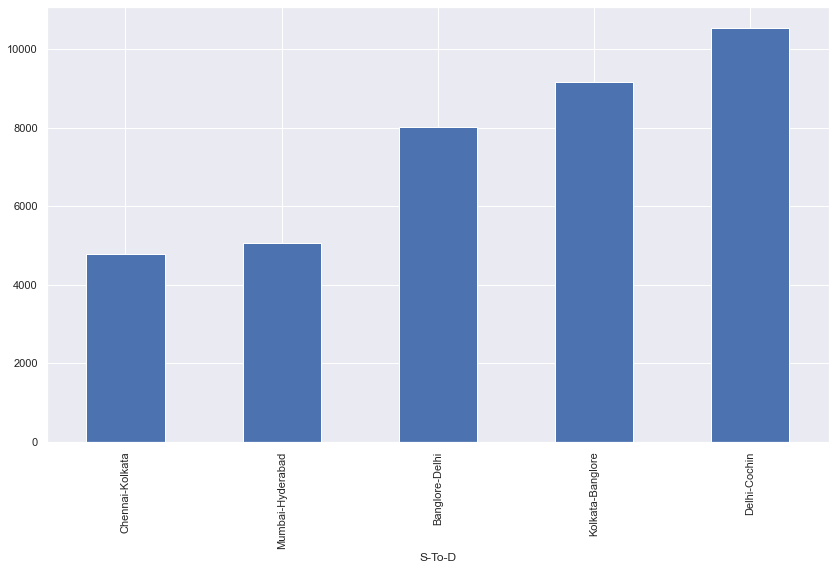

In [19]:
plt.figure(figsize=[14,8])

train.groupby(['S-To-D'])['Price'].mean().sort_values().plot.bar();

In [20]:
# We can see that pattern is there.Delhi to Cochin is highest in price & Chennai to Kolkata is lowest in price.

## Creating New Column Distance between source & destination

In [21]:
train['S-To-D'].unique()

array(['Banglore-Delhi', 'Kolkata-Banglore', 'Delhi-Cochin',
       'Chennai-Kolkata', 'Mumbai-Hyderabad'], dtype=object)

In [22]:
def distance(x):
    return x.map({
        'Banglore-Delhi':1707,
        'Kolkata-Banglore':1560,
        'Delhi-Cochin': 2046,
        'Chennai-Kolkata':1366,
        'Mumbai-Hyderabad':617
        
        
    })
train['Distance']=train[['S-To-D']].apply(distance)


In [23]:
train.head(50)

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance
0,IndiGo,24/03/2019,Banglore,Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897,Banglore-Delhi,1707
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662,Kolkata-Banglore,1560
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882,Delhi-Cochin,2046
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218,Kolkata-Banglore,1560
4,IndiGo,01/03/2019,Banglore,Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302,Banglore-Delhi,1707
5,SpiceJet,24/06/2019,Kolkata,Banglore,CCU → BLR,09:00,11:25,2h 25m,non-stop,No info,3873,Kolkata-Banglore,1560
6,Jet Airways,12/03/2019,Banglore,Delhi,BLR → BOM → DEL,18:55,10:25 13 Mar,15h 30m,1 stop,In-flight meal not included,11087,Banglore-Delhi,1707
7,Jet Airways,01/03/2019,Banglore,Delhi,BLR → BOM → DEL,08:00,05:05 02 Mar,21h 5m,1 stop,No info,22270,Banglore-Delhi,1707
8,Jet Airways,12/03/2019,Banglore,Delhi,BLR → BOM → DEL,08:55,10:25 13 Mar,25h 30m,1 stop,In-flight meal not included,11087,Banglore-Delhi,1707
9,Multiple carriers,27/05/2019,Delhi,Cochin,DEL → BOM → COK,11:25,19:15,7h 50m,1 stop,No info,8625,Delhi-Cochin,2046


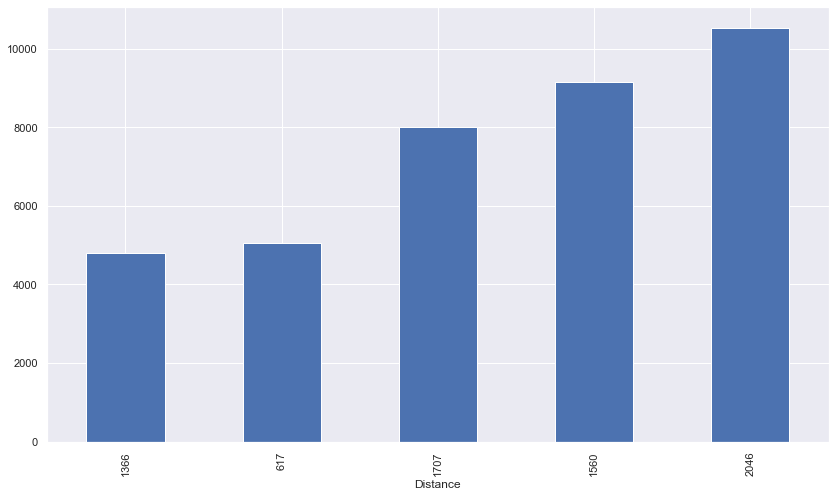

In [24]:
plt.figure(figsize=[14,8])

train.groupby(['Distance'])['Price'].mean().sort_values().plot.bar();

In [25]:
# We can see that there is some relation between distance between source & destination and price of flight.

## Total_Stops Vs Fare

In [26]:
train['Total_Stops'].unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', nan, '4 stops'],
      dtype=object)

In [27]:
# Checking dataframe which is having null entry.
train[train.Total_Stops.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480,Delhi-Cochin,2046


In [28]:
# Removing this dataframe having null entry
train=train[-(train.Total_Stops.isnull())]

In [29]:
train['Total_Stops'].unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', '4 stops'],
      dtype=object)

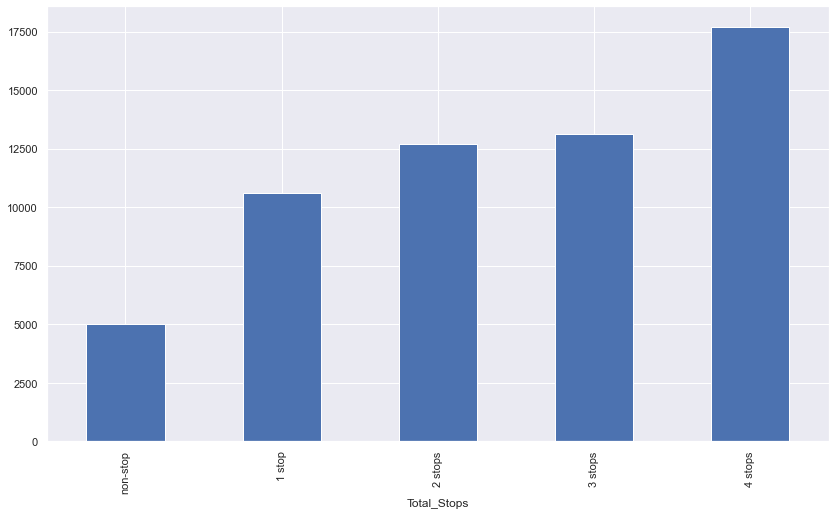

In [30]:
plt.figure(figsize=[14,8])

train.groupby(['Total_Stops'])['Price'].mean().sort_values().plot.bar();

- Here we can see that number of stops is having direct relation with fare.This is because increasing number of stops increases expeenditure incurred in flight.

In [31]:
# Converting to numerical values.

def stoppage(x):
    return x.map({
        'non-stop':0,
        '1 stop':1,
        '2 stops':2,
        '3 stops':3,
        '4 stops':4
        
        
    })
train['Total_Stops']=train[['Total_Stops']].apply(stoppage)


In [32]:
train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance
0,IndiGo,24/03/2019,Banglore,Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,0,No info,3897,Banglore-Delhi,1707
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2,No info,7662,Kolkata-Banglore,1560
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2,No info,13882,Delhi-Cochin,2046
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1,No info,6218,Kolkata-Banglore,1560
4,IndiGo,01/03/2019,Banglore,Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1,No info,13302,Banglore-Delhi,1707


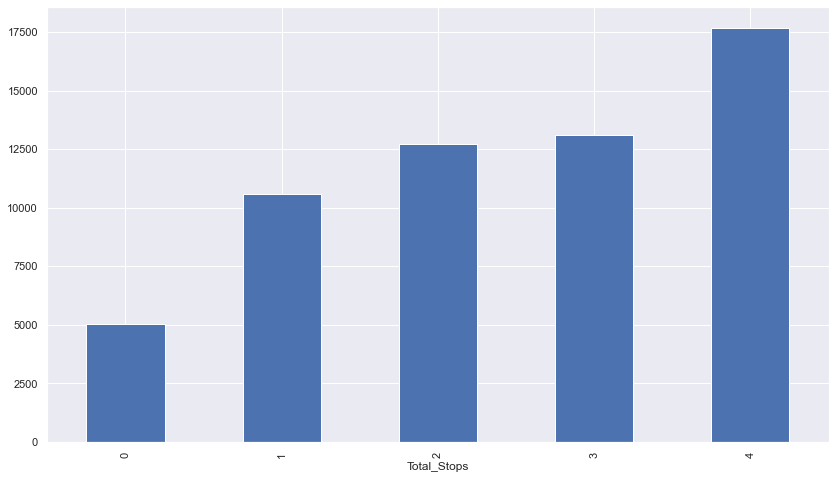

In [33]:
plt.figure(figsize=[14,8])

train.groupby(['Total_Stops'])['Price'].mean().sort_values().plot.bar();

## Feature Date Of Journey 

In [34]:
train['Date_of_Journey'] = pd.to_datetime(train['Date_of_Journey'])


In [35]:
# Creating New Feature " Monthy of Journey"
train['Month_of_Journey'] = train['Date_of_Journey'].dt.month

In [36]:
train

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance,Month_of_Journey
0,IndiGo,2019-03-24,Banglore,Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,0,No info,3897,Banglore-Delhi,1707,3
1,Air India,2019-01-05,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2,No info,7662,Kolkata-Banglore,1560,1
2,Jet Airways,2019-09-06,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2,No info,13882,Delhi-Cochin,2046,9
3,IndiGo,2019-12-05,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1,No info,6218,Kolkata-Banglore,1560,12
4,IndiGo,2019-01-03,Banglore,Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1,No info,13302,Banglore-Delhi,1707,1
5,SpiceJet,2019-06-24,Kolkata,Banglore,CCU → BLR,09:00,11:25,2h 25m,0,No info,3873,Kolkata-Banglore,1560,6
6,Jet Airways,2019-12-03,Banglore,Delhi,BLR → BOM → DEL,18:55,10:25 13 Mar,15h 30m,1,In-flight meal not included,11087,Banglore-Delhi,1707,12
7,Jet Airways,2019-01-03,Banglore,Delhi,BLR → BOM → DEL,08:00,05:05 02 Mar,21h 5m,1,No info,22270,Banglore-Delhi,1707,1
8,Jet Airways,2019-12-03,Banglore,Delhi,BLR → BOM → DEL,08:55,10:25 13 Mar,25h 30m,1,In-flight meal not included,11087,Banglore-Delhi,1707,12
9,Multiple carriers,2019-05-27,Delhi,Cochin,DEL → BOM → COK,11:25,19:15,7h 50m,1,No info,8625,Delhi-Cochin,2046,5


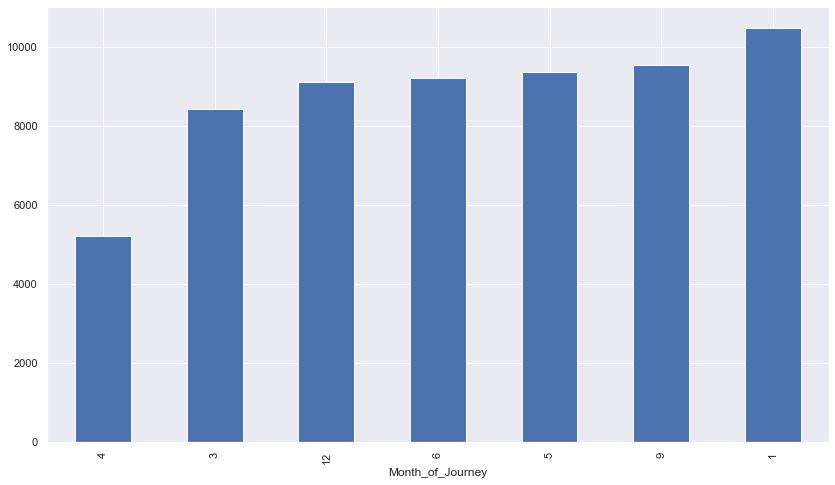

In [37]:
plt.figure(figsize=[14,8])
train.groupby(['Month_of_Journey'])['Price'].mean().sort_values().plot.bar();

In [116]:
# Some pattern is there between Month of Journey and Price.
# Some pattern is there.Fares are highest for Januaury and lowest for april month.

## Feature Day of Week

In [39]:
train['DayOfWeek']=train['Date_of_Journey'].dt.dayofweek.apply(lambda x:0 if x in range(0,5) else 1)

#0 refers to weekday.
#1 refres to weekend.

In [40]:
train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek
0,IndiGo,2019-03-24,Banglore,Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,0,No info,3897,Banglore-Delhi,1707,3,1
1,Air India,2019-01-05,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2,No info,7662,Kolkata-Banglore,1560,1,1
2,Jet Airways,2019-09-06,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2,No info,13882,Delhi-Cochin,2046,9,0
3,IndiGo,2019-12-05,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1,No info,6218,Kolkata-Banglore,1560,12,0
4,IndiGo,2019-01-03,Banglore,Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1,No info,13302,Banglore-Delhi,1707,1,0


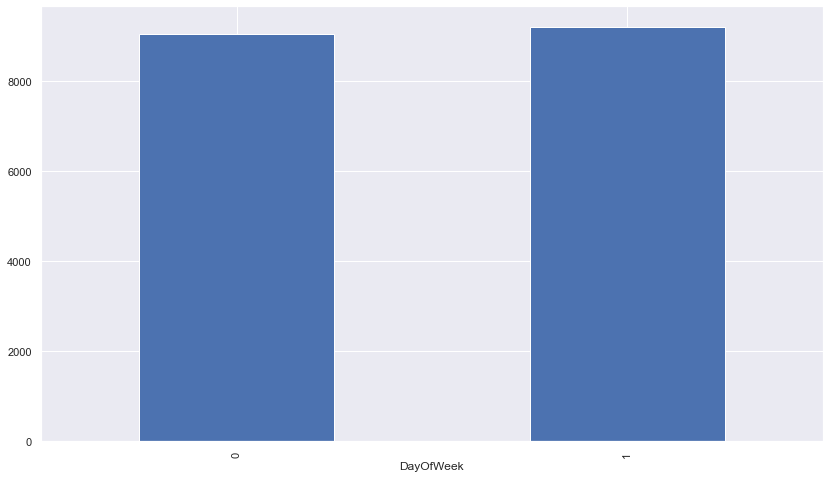

In [41]:
plt.figure(figsize=[14,8])
train.groupby(['DayOfWeek'])['Price'].mean().sort_values().plot.bar();

In [42]:
# We can see that fares as expected higher for weekends.

## Feature Departure Time 
- Dividing departure time into categories for maximum data input to the model
- Early Morning : Before 6 , 6 to 12am , 12am to 6pm , after 6pm


In [43]:
train['Dep_Time']

0        22:20
1        05:50
2        09:25
3        18:05
4        16:50
5        09:00
6        18:55
7        08:00
8        08:55
9        11:25
10       09:45
11       20:20
12       11:40
13       21:10
14       17:15
15       16:40
16       08:45
17       14:00
18       20:15
19       16:00
20       14:10
21       22:00
22       04:00
23       18:55
24       18:55
25       21:25
26       21:50
27       07:00
28       09:45
29       07:05
30       07:05
31       09:50
32       04:00
33       14:35
34       07:05
35       10:35
36       15:05
37       14:15
38       07:00
39       07:05
40       07:05
41       06:45
42       20:55
43       11:10
44       09:00
45       05:45
46       04:00
47       11:40
48       19:00
49       23:05
50       11:00
51       09:35
52       22:20
53       21:15
54       23:55
55       19:45
56       08:50
57       07:05
58       19:00
59       15:40
60       09:25
61       06:05
62       08:45
63       15:00
64       07:05
65       10:35
66       0

In [44]:
train['Dep_Time'] = pd.to_datetime(train['Dep_Time'])

In [45]:
def condition(x):
    if x<=6:
        return 0
    if x>=6 and x<12:
        return 1
    if x>=12 and x<18:
        return 2
    else:
        return 3
    
    
    
train['Dep_Time_Slot']=train['Dep_Time'].dt.hour.apply(condition)

In [46]:

train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,Dep_Time_Slot
0,IndiGo,2019-03-24,Banglore,Delhi,BLR → DEL,2022-01-07 22:20:00,01:10 22 Mar,2h 50m,0,No info,3897,Banglore-Delhi,1707,3,1,3
1,Air India,2019-01-05,Kolkata,Banglore,CCU → IXR → BBI → BLR,2022-01-07 05:50:00,13:15,7h 25m,2,No info,7662,Kolkata-Banglore,1560,1,1,0
2,Jet Airways,2019-09-06,Delhi,Cochin,DEL → LKO → BOM → COK,2022-01-07 09:25:00,04:25 10 Jun,19h,2,No info,13882,Delhi-Cochin,2046,9,0,1
3,IndiGo,2019-12-05,Kolkata,Banglore,CCU → NAG → BLR,2022-01-07 18:05:00,23:30,5h 25m,1,No info,6218,Kolkata-Banglore,1560,12,0,3
4,IndiGo,2019-01-03,Banglore,Delhi,BLR → NAG → DEL,2022-01-07 16:50:00,21:35,4h 45m,1,No info,13302,Banglore-Delhi,1707,1,0,2


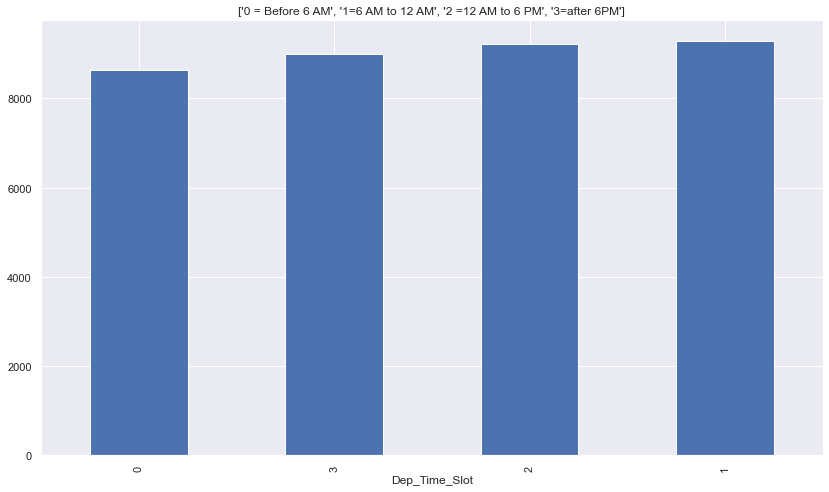

In [47]:
plt.figure(figsize=[14,8])
train.groupby(['Dep_Time_Slot'])['Price'].mean().sort_values().plot.bar();
l=['0 = Before 6 AM','1=6 AM to 12 AM','2 =12 AM to 6 PM','3=after 6PM']
plt.title(l);

- Here we can see that flight price is lowest for early morning departure flight and highest for time 6am to 12 am which is idle/confortable for all travellers.

## Feature Duration into one unit i.e. minutes

In [48]:
train['Duration']=  train['Duration'].str.replace("h", '*60').str.replace(' ','+').str.replace('m','*1').apply(eval)

# converts your string into an equation in string format and evaluates it.

In [49]:
train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,Dep_Time_Slot
0,IndiGo,2019-03-24,Banglore,Delhi,BLR → DEL,2022-01-07 22:20:00,01:10 22 Mar,170,0,No info,3897,Banglore-Delhi,1707,3,1,3
1,Air India,2019-01-05,Kolkata,Banglore,CCU → IXR → BBI → BLR,2022-01-07 05:50:00,13:15,445,2,No info,7662,Kolkata-Banglore,1560,1,1,0
2,Jet Airways,2019-09-06,Delhi,Cochin,DEL → LKO → BOM → COK,2022-01-07 09:25:00,04:25 10 Jun,1140,2,No info,13882,Delhi-Cochin,2046,9,0,1
3,IndiGo,2019-12-05,Kolkata,Banglore,CCU → NAG → BLR,2022-01-07 18:05:00,23:30,325,1,No info,6218,Kolkata-Banglore,1560,12,0,3
4,IndiGo,2019-01-03,Banglore,Delhi,BLR → NAG → DEL,2022-01-07 16:50:00,21:35,285,1,No info,13302,Banglore-Delhi,1707,1,0,2


# Encoding of Categorical Variable

In [50]:
train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,Dep_Time_Slot
0,IndiGo,2019-03-24,Banglore,Delhi,BLR → DEL,2022-01-07 22:20:00,01:10 22 Mar,170,0,No info,3897,Banglore-Delhi,1707,3,1,3
1,Air India,2019-01-05,Kolkata,Banglore,CCU → IXR → BBI → BLR,2022-01-07 05:50:00,13:15,445,2,No info,7662,Kolkata-Banglore,1560,1,1,0
2,Jet Airways,2019-09-06,Delhi,Cochin,DEL → LKO → BOM → COK,2022-01-07 09:25:00,04:25 10 Jun,1140,2,No info,13882,Delhi-Cochin,2046,9,0,1
3,IndiGo,2019-12-05,Kolkata,Banglore,CCU → NAG → BLR,2022-01-07 18:05:00,23:30,325,1,No info,6218,Kolkata-Banglore,1560,12,0,3
4,IndiGo,2019-01-03,Banglore,Delhi,BLR → NAG → DEL,2022-01-07 16:50:00,21:35,285,1,No info,13302,Banglore-Delhi,1707,1,0,2


In [51]:
train1=train.copy()

In [52]:
train1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Airline           10682 non-null  object        
 1   Date_of_Journey   10682 non-null  datetime64[ns]
 2   Source            10682 non-null  object        
 3   Destination       10682 non-null  object        
 4   Route             10682 non-null  object        
 5   Dep_Time          10682 non-null  datetime64[ns]
 6   Arrival_Time      10682 non-null  object        
 7   Duration          10682 non-null  int64         
 8   Total_Stops       10682 non-null  int64         
 9   Additional_Info   10682 non-null  object        
 10  Price             10682 non-null  int64         
 11  S-To-D            10682 non-null  object        
 12  Distance          10682 non-null  int64         
 13  Month_of_Journey  10682 non-null  int64         
 14  DayOfWeek         1068

In [53]:
# Removing irrelevant features

In [54]:
train1=train1.drop(['Date_of_Journey','Route','Dep_Time','Arrival_Time','Additional_Info'],axis=1)

In [55]:
train1.head()

,Airline,Source,Destination,Duration,Total_Stops,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,Dep_Time_Slot
0,IndiGo,Banglore,Delhi,170,0,3897,Banglore-Delhi,1707,3,1,3
1,Air India,Kolkata,Banglore,445,2,7662,Kolkata-Banglore,1560,1,1,0
2,Jet Airways,Delhi,Cochin,1140,2,13882,Delhi-Cochin,2046,9,0,1
3,IndiGo,Kolkata,Banglore,325,1,6218,Kolkata-Banglore,1560,12,0,3
4,IndiGo,Banglore,Delhi,285,1,13302,Banglore-Delhi,1707,1,0,2


In [56]:
train1[['Month_of_Journey','DayOfWeek','Dep_Time_Slot']]=train1[['Month_of_Journey','DayOfWeek','Dep_Time_Slot']].astype('str')

In [57]:
train1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Airline           10682 non-null  object
 1   Source            10682 non-null  object
 2   Destination       10682 non-null  object
 3   Duration          10682 non-null  int64 
 4   Total_Stops       10682 non-null  int64 
 5   Price             10682 non-null  int64 
 6   S-To-D            10682 non-null  object
 7   Distance          10682 non-null  int64 
 8   Month_of_Journey  10682 non-null  object
 9   DayOfWeek         10682 non-null  object
 10  Dep_Time_Slot     10682 non-null  object
dtypes: int64(4), object(7)
memory usage: 1001.4+ KB


In [58]:
col=['Airline','Source','Destination','Month_of_Journey','DayOfWeek','Dep_Time_Slot','S-To-D']

In [59]:
# Creating a dummy variable for some of the categorical variables and dropping the first one.
dummy1 = pd.get_dummies(train1[col],drop_first=True)
# Adding the results to the master dataframe
train1 = pd.concat([train1, dummy1], axis=1)


In [60]:
dummy1

,Airline_Air India,Airline_GoAir,Airline_IndiGo,Airline_Jet Airways,Airline_Jet Airways Business,Airline_Multiple carriers,Airline_Multiple carriers Premium economy,Airline_SpiceJet,Airline_Trujet,Airline_Vistara,...,Month_of_Journey_6,Month_of_Journey_9,DayOfWeek_1,Dep_Time_Slot_1,Dep_Time_Slot_2,Dep_Time_Slot_3,S-To-D_Chennai-Kolkata,S-To-D_Delhi-Cochin,S-To-D_Kolkata-Banglore,S-To-D_Mumbai-Hyderabad
0,0,0,1,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,0,0,0,1,0,0,0,0,0,0,...,0,1,0,1,0,0,0,1,0,0
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
5,0,0,0,0,0,0,0,1,0,0,...,1,0,0,1,0,0,0,0,1,0
6,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
7,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
8,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
9,0,0,0,0,0,1,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0


In [61]:
train1.head()

,Airline,Source,Destination,Duration,Total_Stops,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,...,Month_of_Journey_6,Month_of_Journey_9,DayOfWeek_1,Dep_Time_Slot_1,Dep_Time_Slot_2,Dep_Time_Slot_3,S-To-D_Chennai-Kolkata,S-To-D_Delhi-Cochin,S-To-D_Kolkata-Banglore,S-To-D_Mumbai-Hyderabad
0,IndiGo,Banglore,Delhi,170,0,3897,Banglore-Delhi,1707,3,1,...,0,0,1,0,0,1,0,0,0,0
1,Air India,Kolkata,Banglore,445,2,7662,Kolkata-Banglore,1560,1,1,...,0,0,1,0,0,0,0,0,1,0
2,Jet Airways,Delhi,Cochin,1140,2,13882,Delhi-Cochin,2046,9,0,...,0,1,0,1,0,0,0,1,0,0
3,IndiGo,Kolkata,Banglore,325,1,6218,Kolkata-Banglore,1560,12,0,...,0,0,0,0,0,1,0,0,1,0
4,IndiGo,Banglore,Delhi,285,1,13302,Banglore-Delhi,1707,1,0,...,0,0,0,0,1,0,0,0,0,0


In [62]:
train1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 44 columns):
 #   Column                                     Non-Null Count  Dtype 
---  ------                                     --------------  ----- 
 0   Airline                                    10682 non-null  object
 1   Source                                     10682 non-null  object
 2   Destination                                10682 non-null  object
 3   Duration                                   10682 non-null  int64 
 4   Total_Stops                                10682 non-null  int64 
 5   Price                                      10682 non-null  int64 
 6   S-To-D                                     10682 non-null  object
 7   Distance                                   10682 non-null  int64 
 8   Month_of_Journey                           10682 non-null  object
 9   DayOfWeek                                  10682 non-null  object
 10  Dep_Time_Slot                     

# Scaling of Numerical Variables

In [63]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

train1[['Distance','Duration']] = scaler.fit_transform(train1[['Distance','Duration']])

In [64]:
train1.head()

,Airline,Source,Destination,Duration,Total_Stops,Price,S-To-D,Distance,Month_of_Journey,DayOfWeek,...,Month_of_Journey_6,Month_of_Journey_9,DayOfWeek_1,Dep_Time_Slot_1,Dep_Time_Slot_2,Dep_Time_Slot_3,S-To-D_Chennai-Kolkata,S-To-D_Delhi-Cochin,S-To-D_Kolkata-Banglore,S-To-D_Mumbai-Hyderabad
0,IndiGo,Banglore,Delhi,-0.931498,0,3897,Banglore-Delhi,-0.057410,3,1,...,0,0,1,0,0,1,0,0,0,0
1,Air India,Kolkata,Banglore,-0.389953,2,7662,Kolkata-Banglore,-0.456267,1,1,...,0,0,1,0,0,0,0,0,1,0
2,Jet Airways,Delhi,Cochin,0.978679,2,13882,Delhi-Cochin,0.862404,9,0,...,0,1,0,1,0,0,0,1,0,0
3,IndiGo,Kolkata,Banglore,-0.626263,1,6218,Kolkata-Banglore,-0.456267,12,0,...,0,0,0,0,0,1,0,0,1,0
4,IndiGo,Banglore,Delhi,-0.705034,1,13302,Banglore-Delhi,-0.057410,1,0,...,0,0,0,0,1,0,0,0,0,0


In [65]:
# Removing features which are not required anymore
train1=train1.drop(['Airline','Source','Destination','Month_of_Journey','DayOfWeek','Dep_Time_Slot','S-To-D'],axis=1)

In [66]:
train1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 37 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Duration                                   10682 non-null  float64
 1   Total_Stops                                10682 non-null  int64  
 2   Price                                      10682 non-null  int64  
 3   Distance                                   10682 non-null  float64
 4   Airline_Air India                          10682 non-null  uint8  
 5   Airline_GoAir                              10682 non-null  uint8  
 6   Airline_IndiGo                             10682 non-null  uint8  
 7   Airline_Jet Airways                        10682 non-null  uint8  
 8   Airline_Jet Airways Business               10682 non-null  uint8  
 9   Airline_Multiple carriers                  10682 non-null  uint8  
 10  Airline_Multiple carri

# Extracting only Imp Features

In [67]:
# This is done to select only important features for model building in order to avoid problem of " Overfitting".

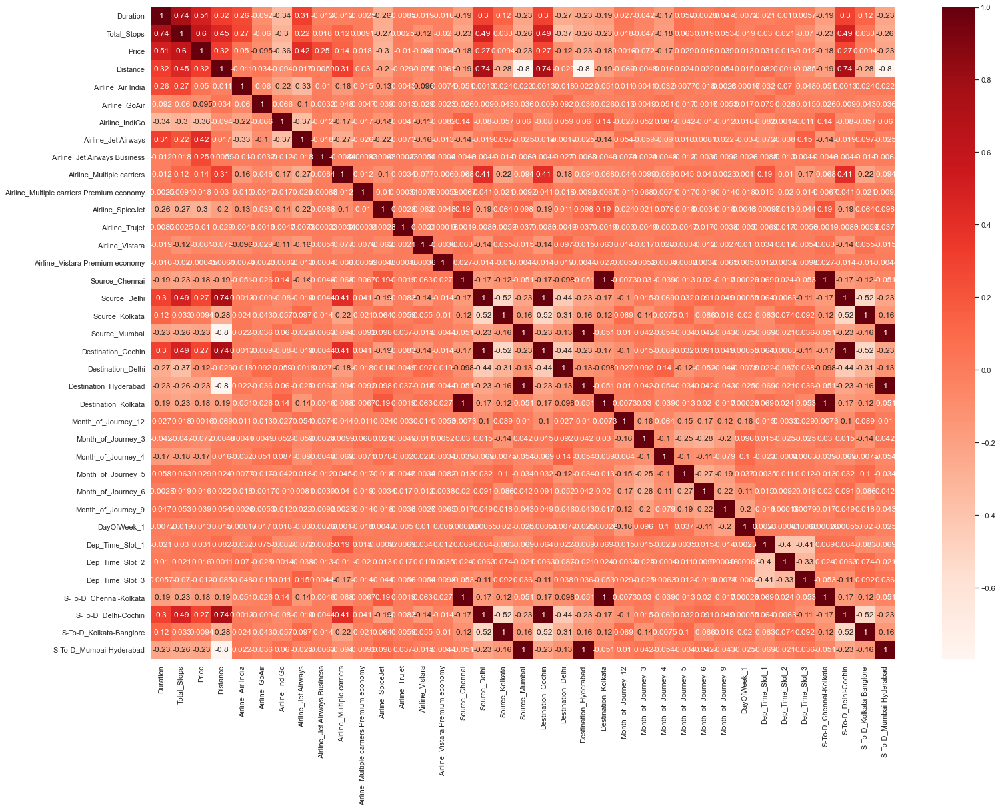

In [68]:
plt.figure(figsize=(25,18))
sns.heatmap(train1.corr(),annot=True ,cmap='Reds')
plt.show()

In [69]:
cor=train.corr()
#cor_target = abs(cor["RUL"])
#Selecting highly correlated features
train_relevant_features = cor[abs(cor['Price'])>=0.001]

train_relevant_features['Price']

Duration            0.506480
Total_Stops         0.603897
Price               1.000000
Distance            0.320708
Month_of_Journey    0.010705
DayOfWeek           0.013248
Dep_Time_Slot       0.011895
Name: Price, dtype: float64

# Building Basic Model

In [70]:
# Seperating Dependent and Independent variable

y_train=train1['Price']
X_train1=train1.drop(['Price'],axis=1)

In [71]:
# first create an evaluate function
def evaluate(y_true, y_hat, label='test'):
    mse = mean_squared_error(y_true, y_hat)
    rmse = np.sqrt(mse)
    variance = r2_score(y_true, y_hat)
    print('{} set RMSE:{}, R2:{}'.format(label, rmse, variance))
    return rmse,variance;

### Model 1: Linear Regression

In [72]:
# create and fit model
lm = LinearRegression()
lm.fit(X_train1, y_train)

# predict and evaluate
y_hat_train1 = lm.predict(X_train1)
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1,'train')

y_hat_test1 = lm.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1,'test')


train set RMSE:2985.820320212228, R2:0.5807487387185863
test set RMSE:2985.820320212228, R2:0.5807487387185863


In [73]:
# Make Dataframe which will contain results of all applied Model
Results=pd.DataFrame({'Model':['LR'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]})
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.82032,0.580749,2985.82032,0.580749


### Model 2 : Applying SVM Model

In [74]:
from sklearn.svm import SVR
regressor = SVR(kernel = 'rbf')
regressor.fit(X_train1, y_train)

# predict and evaluate
y_hat_train1 = regressor.predict(X_train1)
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1)

y_hat_test1 = regressor.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1)


test set RMSE:4380.965062924513, R2:0.09741810281099372
test set RMSE:4380.965062924513, R2:0.09741810281099372


In [75]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['SVM'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418


### Model 3 : Using Decision Tree

In [76]:
from sklearn.tree import DecisionTreeRegressor

In [77]:
dt = DecisionTreeRegressor(random_state=42, max_depth=15, min_samples_leaf=10)

In [78]:
dt.fit(X_train1, y_train)

DecisionTreeRegressor(max_depth=15, min_samples_leaf=10, random_state=42)

In [79]:
y_hat_train1 = dt.predict(X_train1)

In [80]:
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1, 'train')

train set RMSE:2407.0218700106316, R2:0.7275372650743486


In [81]:
y_hat_test1 = dt.predict(X_train1)

In [82]:
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1)

test set RMSE:2407.0218700106316, R2:0.7275372650743486


In [83]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['DT'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418
2,DT,2407.021870,0.727537,2407.021870,0.727537


- RMSE & R2 score has further increased. There is some overfitting happening as we have kept maximum depth of model high.This can be addressed seperately.

### Model 4 : Using Random Forest

In [84]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor(random_state=42, n_jobs=-1, max_depth=6, min_samples_leaf=5)
rf.fit(X_train1, y_train)
y_hat_train1 = rf.predict(X_train1)
# Evaluating on Train Data Set
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1, 'train')

train set RMSE:2701.7557599904503, R2:0.6567273432747621


In [85]:
# Evaluating on Test Data Set
y_hat_test1 = rf.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1)

test set RMSE:2701.7557599904503, R2:0.6567273432747621


In [86]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['DF'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418
2,DT,2407.021870,0.727537,2407.021870,0.727537
3,DF,2701.755760,0.656727,2701.755760,0.656727


- Applying Random forest model which is an bagging technique of ensemble type of model , our model overfitting model has been avoided.

- Know important features.This is property of Random Forest Model
rf.feature_importances_



In [87]:
imp_df = pd.DataFrame({
    "Varname": X_train1.columns,
    "Imp": rf.feature_importances_})

In [88]:
imp_df.sort_values(by="Imp", ascending=False)

,Varname,Imp
0,Duration,0.683815
6,Airline_Jet Airways,0.086410
23,Month_of_Journey_3,0.039654
1,Total_Stops,0.039069
19,Destination_Delhi,0.031993
8,Airline_Multiple carriers,0.025693
22,Month_of_Journey_12,0.021055
26,Month_of_Journey_6,0.010335
5,Airline_IndiGo,0.009503
2,Distance,0.005479


- Above is the list of important features strongly affecting the price.

- Using Grid Search for Hyperparameter Tuning

In [89]:
from sklearn.model_selection import GridSearchCV
rf = RandomForestRegressor(random_state=42, n_jobs=-1)


In [90]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [1, 2, 5, 10, 20],
    'min_samples_leaf': [5, 10, 20, 50, 100],
    'max_features': [2,3,4,5,6],
    'n_estimators': [10, 30, 50, 100]
}

In [91]:
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf, param_grid=params, 
                          cv=4, n_jobs=-1, verbose=1)

In [92]:
%%time
grid_search.fit(X_train1, y_train)

Fitting 4 folds for each of 500 candidates, totalling 2000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   11.7s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   26.4s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   53.2s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  4.3min finished


Wall time: 4min 18s


GridSearchCV(cv=4, estimator=RandomForestRegressor(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [1, 2, 5, 10, 20],
                         'max_features': [2, 3, 4, 5, 6],
                         'min_samples_leaf': [5, 10, 20, 50, 100],
                         'n_estimators': [10, 30, 50, 100]},
             verbose=1)

In [93]:
rf_best = grid_search.best_estimator_

In [94]:
y_hat_train = rf_best.predict(X_train1)

In [95]:
# Evaluating on Train Data Set
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1, 'train')

train set RMSE:2701.7557599904503, R2:0.6567273432747621


In [96]:
# Evaluating on Test Data Set
y_hat_test1 = rf_best.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1)

test set RMSE:2432.487500570876, R2:0.7217416062924233


In [97]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['DF with Tuning'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418
2,DT,2407.021870,0.727537,2407.021870,0.727537
3,DF,2701.755760,0.656727,2701.755760,0.656727
4,DF with Tuning,2701.755760,0.656727,2432.487501,0.721742


- DF with hyperparamater tuning model perfomance has further improved.

### Model 6 : XG Boost Algorithm

In [98]:
import xgboost as xg
# Instantiation
xgb_r = xg.XGBRegressor(objective ='reg:linear',
                  n_estimators = 10, seed = 123)
xgb_r.fit(X_train1, y_train)


[10:16:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=10, n_jobs=8, num_parallel_tree=1,
             objective='reg:linear', random_state=123, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, seed=123, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [99]:
# Evaluating on Train Data Set
y_hat_train1 = xgb_r.predict(X_train1)
# Evaluating on Train Data Set
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1, 'train')

train set RMSE:2350.724564148547, R2:0.7401333605413554


In [100]:
# Evaluating on Test Data Set
y_hat_test1 = xgb_r.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1)

test set RMSE:2350.724564148547, R2:0.7401333605413554


In [101]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['XgBoost'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418
2,DT,2407.021870,0.727537,2407.021870,0.727537
3,DF,2701.755760,0.656727,2701.755760,0.656727
4,DF with Tuning,2701.755760,0.656727,2432.487501,0.721742
5,XgBoost,2350.724564,0.740133,2350.724564,0.740133


- With Xgboost model which is favourite for Kaggle competitions and very powerful model , accuracy has increased.We can see that over model is not overfitting as XGboost offers regularized gradient boosting framework.

### Model 6 : Neural Network Model

In [102]:
import tensorflow as tf

In [103]:
ann = tf.keras.models.Sequential()

In [104]:
ann.add(tf.keras.layers.Dense(units=40, activation='relu'))

In [105]:
ann.add(tf.keras.layers.Dense(units=10, activation='relu'))

In [106]:
ann.add(tf.keras.layers.Dense(units=10, activation='relu'))

In [107]:
ann.add(tf.keras.layers.Dense(units=1, activation='linear'))

In [108]:
ann.compile(optimizer='rmsprop', loss='mse', metrics=['mae'])

In [109]:
ann.fit(X_train1, y_train, batch_size = 32, epochs = 75)

Epoch 1/75

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

334/334 [==============================] - 0s 1ms/step - loss: 102481888.0000 - mae: 9016.6416
Epoch 2/75
334/334 [==============================] - 0s 1ms/step - loss: 82633176.0000 - mae: 7902.1934
Epoch 3/75
334/334 [==============================] - 0s 1ms/step - loss: 30700198.0000 - mae: 3930.2112
Epoch 4/75
334/334 [==============================] - 1s 2ms/step - loss: 14124655.0000 - mae: 2491.5464
Epoch 5/75
334/334 [==============================] - 1s 2ms/step - loss: 12845446.0000

334/334 [==============================] - 1s 2ms/step - loss: 9443319.0000 - mae: 2012.6841
Epoch 72/75
334/334 [==============================] - 1s 2ms/step - loss: 9419831.0000 - mae: 2011.3147
Epoch 73/75
334/334 [==============================] - 1s 2ms/step - loss: 9397736.0000 - mae: 2013.3247
Epoch 74/75
334/334 [==============================] - 1s 2ms/step - loss: 9375385.0000 - mae: 2008.6066
Epoch 75/75
334/334 [==============================] - 0s 1ms/step - loss: 9345685.0000 - mae: 2010.6725


In [110]:
# Evaluating on Train Data Set
y_hat_train1 = ann.predict(X_train1)

# Evaluating on Train Data Set
RMSE_Train,R2_Train=evaluate(y_train, y_hat_train1, 'train')

train set RMSE:3057.8936638752107, R2:0.5602642271530487


In [111]:
# Evaluating on Test Data Set
y_hat_test1 = ann.predict(X_train1)
RMSE_Test,R2_Test=evaluate(y_train, y_hat_test1,'test')

test set RMSE:3057.8936638752107, R2:0.5602642271530487


In [112]:
# Make Dataframe which will contain results of all applied Model
Results=Results.append(pd.DataFrame({'Model':['ANN'],'RMSE-Train':[RMSE_Train],'R2-Train':[R2_Train],'RMSE-Test':[RMSE_Test],'R2-Test':[R2_Test]}),ignore_index=True)
Results

,Model,RMSE-Train,R2-Train,RMSE-Test,R2-Test
0,LR,2985.820320,0.580749,2985.820320,0.580749
1,SVM,4380.965063,0.097418,4380.965063,0.097418
2,DT,2407.021870,0.727537,2407.021870,0.727537
3,DF,2701.755760,0.656727,2701.755760,0.656727
4,DF with Tuning,2701.755760,0.656727,2432.487501,0.721742
5,XgBoost,2350.724564,0.740133,2350.724564,0.740133
6,ANN,3057.893664,0.560264,3057.893664,0.560264


- With ANN model perfomance is nearby to the XgBoost Model